## Setup

### Import pandas

In [30]:
import pandas as pd

# Load Data 


In [31]:
df1 = pd.read_csv('/home/sepehr/uni/data_mining/all_video_games/vgchartz-2024.csv')
df2 = pd.read_csv('/home/sepehr/uni/data_mining/all_video_games/all_video_games(cleaned).csv')

# Merge Dataset

In [32]:
merged_df = pd.merge(df1, df2, left_on='title', right_on='Title', how='inner')

## delete duplicate column and unnecessary column

In [33]:
merged_df.drop(columns=['Title', 'Release Date', 'genre', 'publisher', 'developer', 'img'], inplace=True)


In [34]:
print("Final Merged Dataset:\n", merged_df.head())

Final Merged Dataset:
                             title console  critic_score  total_sales  \
0              Grand Theft Auto V     PS3           9.4        20.32   
1              Grand Theft Auto V     PS4           9.7        19.39   
2     Grand Theft Auto: Vice City     PS2           9.6        16.15   
3              Grand Theft Auto V    X360           NaN        15.86   
4  Call of Duty: Modern Warfare 3    X360           8.7        14.82   

   na_sales  jp_sales  pal_sales  other_sales release_date last_update  \
0      6.37      0.99       9.85         3.12   2013-09-17         NaN   
1      6.06      0.60       9.71         3.02   2014-11-18  2018-01-03   
2      8.41      0.47       5.49         1.78   2002-10-28         NaN   
3      9.06      0.06       5.33         1.42   2013-09-17         NaN   
4      9.07      0.13       4.29         1.33   2011-11-08         NaN   

        Developer       Publisher             Genres  \
0  Rockstar North  Rockstar Games  Open-Wor

In [35]:
import ast

def extract_platform_names(platform_info):
    try:
        # Convert the string representation of list/dict to actual list/dict
        platform_data = ast.literal_eval(platform_info)
        # Extract the platform name
        return platform_data[0]['Platform']
    except (ValueError, IndexError, KeyError):
        return None
    
unique_consoles = merged_df['console'].unique()
print("Unique Consoles in df2:\n", unique_consoles)


merged_df['extracted_platform'] = merged_df['Platforms Info'].apply(extract_platform_names)

unique_platforms = merged_df['extracted_platform'].unique()

print("Unique Platforms in df1:\n", unique_platforms)


Unique Consoles in df2:
 ['PS3' 'PS4' 'PS2' 'X360' 'XOne' 'PC' 'PSP' 'Wii' 'PS' 'DS' 'GBA' 'XB'
 'PSV' 'N64' 'GC' 'NS' 'GEN' 'GB' '2600' 'NES' 'WiiU' '3DS' 'SAT' 'DC'
 'SNES' 'WS' 'VC' 'NG' 'PSN' 'XBL' 'GG' 'OSX' 'Mob' 'Series' 'All' 'iOS'
 'DSiW' 'Linux' 'WinP' 'And' 'MS' 'WW' '7800' 'Lynx' '5200' 'S32X' 'NGage'
 'PCE' 'XS' 'PS5' 'CV' 'C64' 'FDS' 'MSX' 'OR' 'iQue' 'Arc' 'SCD' '3DO'
 'PCFX' 'MSD' 'BRW' 'TG16' 'Ouya' 'ApII' 'ACPC' 'AJ' 'DSi' 'Amig' 'CD32'
 'GBC' 'Int' 'GIZ']
Unique Platforms in df1:
 ['PlayStation 3' 'PlayStation 2' 'Xbox 360' 'PC' 'Xbox One'
 'PlayStation 4' 'Nintendo Switch' 'DS' 'PSP' 'iOS (iPhone/iPad)'
 'PlayStation Vita' 'PlayStation' 'Xbox Series X' 'Wii' 'Xbox' 'GameCube'
 'Game Boy Advance' '3DS' 'Nintendo 64' 'Wii U' 'Dreamcast'
 'PlayStation 5' None 'Meta Quest']


## mapping dictionary to standardize the platform names:

In [36]:
platform_mapping = {
    'PS2': 'PlayStation 2',
    'PS3': 'PlayStation 3',
    'PS4': 'PlayStation 4',
    'PS5': 'PlayStation 5',
    'X360': 'Xbox 360',
    'XOne': 'Xbox One',
    'PC': 'PC',
    'PSP': 'PSP',
    'Wii': 'Wii',
    'PS': 'PlayStation',
    'DS': 'DS',
    'GBA': 'Game Boy Advance',
    'XB': 'Xbox',
    'PSV': 'PlayStation Vita',
    'N64': 'Nintendo 64',
    'GC': 'GameCube',
    'NS': 'Nintendo Switch',
    'GEN': 'Genesis', # Assuming 'GEN' stands for 'Genesis'
    'GB': 'Game Boy', # Assuming 'GB' stands for 'Game Boy'
    '2600': 'Atari 2600',
    'NES': 'NES',
    'WiiU': 'Wii U',
    '3DS': '3DS',
    'SAT': 'Saturn',
    'DC': 'Dreamcast',
    'SNES': 'Super Nintendo',
    'WS': 'WonderSwan', # Assuming 'WS' stands for 'WonderSwan'
    'VC': 'Virtual Console',
    'NG': 'Neo Geo',
    'PSN': 'PlayStation Network',
    'XBL': 'Xbox Live',
    'GG': 'Game Gear',
    'OSX': 'Mac OS',
    'Mob': 'Mobile',
    'Series': 'Xbox Series X',
    'All': 'All Platforms',
    'iOS': 'iOS (iPhone/iPad)',
    'DSiW': 'DSiWare',
    'Linux': 'Linux',
    'WinP': 'Windows Phone',
    'And': 'Android',
    'MS': 'MS-DOS',
    'WW': 'Worldwide',
    '7800': 'Atari 7800',
    'Lynx': 'Atari Lynx',
    '5200': 'Atari 5200',
    'S32X': 'Sega 32X',
    'NGage': 'N-Gage',
    'PCE': 'PC Engine',
    'XS': 'Xbox Series X',
    'CV': 'ColecoVision',
    'C64': 'Commodore 64',
    'FDS': 'Famicom Disk System',
    'MSX': 'MSX',
    'OR': 'Oculus Rift',
    'iQue': 'iQue Player',
    'Arc': 'Arcade',
    'SCD': 'Sega CD',
    '3DO': '3DO',
    'PCFX': 'PC-FX',
    'MSD': 'MS-DOS',
    'BRW': 'Brower Games',
    'TG16': 'TurboGrafx-16',
    'Ouya': 'Ouya',
    'ApII': 'Apple II',
    'ACPC': 'Amstrad CPC',
    'AJ': 'Atari Jaguar',
    'DSi': 'Nintendo DSi',
    'Amig': 'Amiga',
    'CD32': 'Amiga CD32',
    'GBC': 'Game Boy Color',
    'Int': 'Intellivision',
    'GIZ': 'Gizmondo'
}

In [37]:
merged_df['standardized_console'] = merged_df['console'].map(platform_mapping).fillna(merged_df['console'])
merged_df = merged_df[merged_df['extracted_platform'] == merged_df['standardized_console']]
merged_df.drop(columns=['extracted_platform', 'standardized_console'], inplace=True)
print("Filtered Merged Dataset:\n", merged_df.head())

# Save the filtered dataset to a new CSV file (optional)
merged_df.to_csv('filtered_merged_dataset.csv', index=False)

Filtered Merged Dataset:
                              title console  critic_score  total_sales  \
0               Grand Theft Auto V     PS3           9.4        20.32   
2      Grand Theft Auto: Vice City     PS2           9.6        16.15   
4   Call of Duty: Modern Warfare 3    X360           8.7        14.82   
7       Call of Duty: Black Ops II    X360           8.4        13.86   
10              Call of Duty: WWII     PS4           8.1        13.40   

    na_sales  jp_sales  pal_sales  other_sales release_date last_update  \
0       6.37      0.99       9.85         3.12   2013-09-17         NaN   
2       8.41      0.47       5.49         1.78   2002-10-28         NaN   
4       9.07      0.13       4.29         1.33   2011-11-08         NaN   
7       8.27      0.07       4.32         1.20   2012-11-13  2018-04-07   
10      4.67      0.40       6.21         2.12   2017-11-03  2017-12-31   

             Developer       Publisher             Genres  \
0       Rockstar North 

### Handle missing data

Let's fill out release_date column using mode.

In [38]:
def printMissingDataState(df):
    print(df.isnull().sum())

# Fill missing values with the mode
mode_date = merged_df['release_date'].mode()[0]  # Get the most frequent date

# Use a dictionary to fill missing values
merged_df.fillna({'release_date': mode_date}, inplace=True)

print(merged_df.shape)
printMissingDataState(merged_df)
print(merged_df.shape)


(7593, 18)
title                    0
console                  0
critic_score          5284
total_sales           3620
na_sales              4180
jp_sales              6394
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score             885
User Ratings Count    1105
Platforms Info           0
dtype: int64
(7593, 18)


Delete useless columns.

In [39]:
def withoutUselessColumns(df):
    # Define the threshold for missing data
    threshold = 0.65  # 70%

    # Calculate the percentage of missing data for each column
    missing_percentage = df.isnull().mean()

    # Drop columns based on the threshold
    return df.loc[:, missing_percentage < threshold]

# Test the function
print(merged_df.shape)

merged_df = withoutUselessColumns(merged_df)
printMissingDataState(merged_df)

print(merged_df.shape)



(7593, 18)
title                    0
console                  0
total_sales           3620
na_sales              4180
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score             885
User Ratings Count    1105
Platforms Info           0
dtype: int64
(7593, 16)


## Fill missing data

### fill user score


In [40]:
genre_means = merged_df.groupby('Genres')['User Score'].mean()
def fill_missing_user_score(row):
    if pd.isnull(row['User Score']):
        return genre_means[row['Genres']]
    else:
        return row['User Score']


merged_df['User Score'] = merged_df.apply(fill_missing_user_score, axis=1)


printMissingDataState(merged_df)
print(merged_df.shape)
merged_df.to_csv('test1.csv', index=False)

title                    0
console                  0
total_sales           3620
na_sales              4180
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score               0
User Ratings Count    1105
Platforms Info           0
dtype: int64
(7593, 16)


### fill User Ratings Count


In [41]:
genre_means = merged_df.groupby('Genres')['User Ratings Count'].mean()

# Function to fill missing values based on genre mean
def fill_missing_ratings_count(row):
    if pd.isnull(row['User Ratings Count']):
        return genre_means[row['Genres']]
    else:
        return row['User Ratings Count']

# Apply the function to fill missing user ratings count
merged_df['User Ratings Count'] = merged_df.apply(fill_missing_ratings_count, axis=1)

printMissingDataState(merged_df)
print(merged_df.shape)

mean_value = merged_df['User Ratings Count'].mean()
merged_df['User Ratings Count'] = merged_df['User Ratings Count'].fillna(round(mean_value))  # Rounding to maintain integer values
printMissingDataState(merged_df)
print(merged_df.shape)
merged_df.to_csv('test1.csv', index=False)

title                    0
console                  0
total_sales           3620
na_sales              4180
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score               0
User Ratings Count       5
Platforms Info           0
dtype: int64
(7593, 16)
title                    0
console                  0
total_sales           3620
na_sales              4180
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score               0
User Ratings Count       0
Platforms Info           0
dtype: int64
(7593, 16)


### fill total sales

In [42]:
genre_means = merged_df.groupby('Genres')['total_sales'].mean()
def fill_missing_user_score(row):
    if pd.isnull(row['total_sales']):
        return genre_means[row['Genres']]
    else:
        return row['total_sales']


merged_df['total_sales'] = merged_df.apply(fill_missing_user_score, axis=1)


printMissingDataState(merged_df)
print(merged_df.shape)


mean_value = merged_df['total_sales'].mean()
merged_df['total_sales'] = merged_df['total_sales'].fillna(round(mean_value))  # Rounding to maintain integer values
printMissingDataState(merged_df)
print(merged_df.shape)

title                    0
console                  0
total_sales              8
na_sales              4180
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score               0
User Ratings Count       0
Platforms Info           0
dtype: int64
(7593, 16)
title                    0
console                  0
total_sales              0
na_sales              4180
pal_sales             4080
other_sales           3767
release_date             0
last_update           4843
Developer                5
Publisher                5
Genres                   0
Genres Splitted          0
Product Rating         722
User Score               0
User Ratings Count       0
Platforms Info           0
dtype: int64
(7593, 16)


### remove na_sales, pal_sales, other_sales and last update because i don't need them

In [43]:
merged_df.drop(columns=['na_sales', 'pal_sales', 'other_sales', 'last_update'], inplace=True)


### Normalization

In [44]:
from sklearn.preprocessing import MinMaxScaler

# Normalize User Ratings Count column
scaler = MinMaxScaler(feature_range=(0, 1))
merged_df['User Ratings Count'] = scaler.fit_transform(merged_df[['User Ratings Count']])
merged_df.to_csv('test1.csv', index=False)
print(merged_df)

                                title console  total_sales release_date  \
0                  Grand Theft Auto V     PS3     20.32000   2013-09-17   
2         Grand Theft Auto: Vice City     PS2     16.15000   2002-10-28   
4      Call of Duty: Modern Warfare 3    X360     14.82000   2011-11-08   
7          Call of Duty: Black Ops II    X360     13.86000   2012-11-13   
10                 Call of Duty: WWII     PS4     13.40000   2017-11-03   
...                               ...     ...          ...          ...   
20741                       Root Film     PS4      0.23087   2020-07-30   
20742               Slay the Princess      PC      0.23087   2020-12-01   
20743  The 25th Ward: The Silver Case      PC      0.23087   2018-03-13   
20746                 The Silver Case      PC      0.23087   2016-10-06   
20750              World End Syndrome     PS4      0.23087   2018-04-26   

                     Developer          Publisher             Genres  \
0               Rockstar No

### Create new attributes

#### Game Age

In [45]:
from datetime import datetime

merged_df['release_date'] = pd.to_datetime(merged_df['release_date'])
merged_df['Game Age'] = (datetime.now() - merged_df['release_date']).dt.days

print(merged_df)

                                title console  total_sales release_date  \
0                  Grand Theft Auto V     PS3     20.32000   2013-09-17   
2         Grand Theft Auto: Vice City     PS2     16.15000   2002-10-28   
4      Call of Duty: Modern Warfare 3    X360     14.82000   2011-11-08   
7          Call of Duty: Black Ops II    X360     13.86000   2012-11-13   
10                 Call of Duty: WWII     PS4     13.40000   2017-11-03   
...                               ...     ...          ...          ...   
20741                       Root Film     PS4      0.23087   2020-07-30   
20742               Slay the Princess      PC      0.23087   2020-12-01   
20743  The 25th Ward: The Silver Case      PC      0.23087   2018-03-13   
20746                 The Silver Case      PC      0.23087   2016-10-06   
20750              World End Syndrome     PS4      0.23087   2018-04-26   

                     Developer          Publisher             Genres  \
0               Rockstar No

#### Popularity Index

In [46]:
# Normalizing both columns first (using Min-Max Scaling here for simplicity)
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

normalizedUserScore = scaler.fit_transform(merged_df[['User Score']])
normalizedUserRatingsCount = scaler.fit_transform(merged_df[['User Ratings Count']])

# Creating a simple weighted sum of both features
merged_df['Popularity Index'] = 0.5 * normalizedUserScore + 0.5 * normalizedUserRatingsCount
merged_df.to_csv('test1.csv', index=False)
print(merged_df)

                                title console  total_sales release_date  \
0                  Grand Theft Auto V     PS3     20.32000   2013-09-17   
2         Grand Theft Auto: Vice City     PS2     16.15000   2002-10-28   
4      Call of Duty: Modern Warfare 3    X360     14.82000   2011-11-08   
7          Call of Duty: Black Ops II    X360     13.86000   2012-11-13   
10                 Call of Duty: WWII     PS4     13.40000   2017-11-03   
...                               ...     ...          ...          ...   
20741                       Root Film     PS4      0.23087   2020-07-30   
20742               Slay the Princess      PC      0.23087   2020-12-01   
20743  The 25th Ward: The Silver Case      PC      0.23087   2018-03-13   
20746                 The Silver Case      PC      0.23087   2016-10-06   
20750              World End Syndrome     PS4      0.23087   2018-04-26   

                     Developer          Publisher             Genres  \
0               Rockstar No

#### Self Published

In [256]:
merged_df['Self Published'] = (merged_df['Developer'] == merged_df['Publisher']).astype(int)

print(merged_df)

                                                   title console  total_sales  \
0                                     Grand Theft Auto V     PS3    20.320000   
2                            Grand Theft Auto: Vice City     PS2    16.150000   
4                         Call of Duty: Modern Warfare 3    X360    14.820000   
7                             Call of Duty: Black Ops II    X360    13.860000   
10                                    Call of Duty: WWII     PS4    13.400000   
12                                  Grand Theft Auto III     PS2    13.100000   
16                                               FIFA 17     PS4    10.940000   
18                                   Grand Theft Auto IV     PS3    10.570000   
19                                  Call of Duty: Ghosts    X360    10.410000   
21                                           Halo: Reach    X360     9.970000   
22                                                Halo 4    X360     9.960000   
23                        Ca

### Remove outliers

#### User Score column

In [257]:
Q1 = merged_df['User Score'].quantile(0.25)
Q3 = merged_df['User Score'].quantile(0.75)
IQR = Q3 - Q1

# Define bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Adjust bounds to respect the inherent limits of the score range, if necessary
lower_bound = max(lower_bound, 0.0)  # Score cannot be less than 0.0
upper_bound = min(upper_bound, 10.0) # Score cannot be more than 10.0

# Filter outliers
merged_df = merged_df[(merged_df['User Score'] >= lower_bound) & (merged_df['User Score'] <= upper_bound)]

print(merged_df)

                                                   title console  total_sales  \
0                                     Grand Theft Auto V     PS3    20.320000   
2                            Grand Theft Auto: Vice City     PS2    16.150000   
7                             Call of Duty: Black Ops II    X360    13.860000   
10                                    Call of Duty: WWII     PS4    13.400000   
12                                  Grand Theft Auto III     PS2    13.100000   
16                                               FIFA 17     PS4    10.940000   
18                                   Grand Theft Auto IV     PS3    10.570000   
19                                  Call of Duty: Ghosts    X360    10.410000   
21                                           Halo: Reach    X360     9.970000   
22                                                Halo 4    X360     9.960000   
23                        Call of Duty 4: Modern Warfare    X360     9.410000   
25                          

#### User Ratings Count

In [258]:
# Calculate Q1 and Q3
Q1 = merged_df['User Ratings Count'].quantile(0.25)
Q3 = merged_df['User Ratings Count'].quantile(0.75)
IQR = Q3 - Q1

# Define bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Adjust bounds to respect the range 0-1
lower_bound = max(lower_bound, 0.0)  # Normalized values cannot be less than 0.0
upper_bound = min(upper_bound, 1.0)  # Normalized values cannot be more than 1.0

# Filter outliers
merged_df = merged_df[(merged_df['User Ratings Count'] >= lower_bound) & (merged_df['User Ratings Count'] <= upper_bound)]

print(merged_df)

                                                   title console  total_sales  \
16                                               FIFA 17     PS4    10.940000   
31                Grand Theft Auto: Liberty City Stories     PSP     7.720000   
38                             Medal of Honor: Frontline     PS2     6.830000   
49                                                Driver      PS     6.270000   
54                                              Tekken 2      PS     5.740000   
56                                          Cooking Mama      DS     5.660000   
63                  Crash Bandicoot: The Wrath of Cortex     PS2     5.420000   
67                                        Tomb Raider II      PS     5.240000   
70                            Medal of Honor: Rising Sun     PS2     5.130000   
73                                        Guitar Hero II     PS2     5.120000   
81                                Tony Hawk's Pro Skater      PS     5.020000   
85                          

#### Game Age

In [259]:
# Calculate Q1 and Q3
Q1 = merged_df['Game Age'].quantile(0.25)
Q3 = merged_df['Game Age'].quantile(0.75)
IQR = Q3 - Q1

# Define bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter outliers
merged_df = merged_df[(merged_df['Game Age'] >= lower_bound) & (merged_df['Game Age'] <= upper_bound)]

print(merged_df)

                                                   title console  total_sales  \
16                                               FIFA 17     PS4    10.940000   
31                Grand Theft Auto: Liberty City Stories     PSP     7.720000   
38                             Medal of Honor: Frontline     PS2     6.830000   
49                                                Driver      PS     6.270000   
54                                              Tekken 2      PS     5.740000   
56                                          Cooking Mama      DS     5.660000   
63                  Crash Bandicoot: The Wrath of Cortex     PS2     5.420000   
67                                        Tomb Raider II      PS     5.240000   
70                            Medal of Honor: Rising Sun     PS2     5.130000   
73                                        Guitar Hero II     PS2     5.120000   
81                                Tony Hawk's Pro Skater      PS     5.020000   
85                          

### total sales

In [260]:
# Calculate Q1 and Q3
Q1 = merged_df['total_sales'].quantile(0.25)
Q3 = merged_df['total_sales'].quantile(0.75)
IQR = Q3 - Q1

# Define bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filter outliers
merged_df = merged_df[(merged_df['total_sales'] >= lower_bound) & (merged_df['total_sales'] <= upper_bound)]

print(merged_df)

                                                   title console  total_sales  \
1070       LEGO Pirates of the Caribbean: The Video Game     PS3     0.960000   
1076                      Mortal Kombat: Deadly Alliance      XB     0.960000   
1077                                        Dark Cloud 2     PS2     0.960000   
1079                                     Gangs of London     PSP     0.960000   
1080                               Driver: San Francisco     PS3     0.950000   
1081                                       Lost Planet 2     PS3     0.950000   
1083                                        ESPN NBA 2K5      XB     0.950000   
1087                                              Kessen     PS2     0.950000   
1088                    Harvest Moon 3D: A New Beginning     3DS     0.950000   
1089                                Hot Shots Golf Fore!     PS2     0.940000   
1090                                    MLB 06: The Show     PS2     0.940000   
1101                    Cast

### Data Reduction

We use binding data reduction methods.

In [261]:
# Define the number of bins
num_bins = 4

# Bin User Score
merged_df['User Score Binned'], user_score_bins = pd.cut(merged_df['User Score'], bins=num_bins, labels=False, retbins=True)

# Bin User Ratings Count
merged_df['User Ratings Count Binned'], user_ratings_bins = pd.cut(merged_df['User Ratings Count'], bins=num_bins, labels=False, retbins=True)

# Bin Game Age
merged_df['Game Age Binned'], game_age_bins = pd.cut(merged_df['Game Age'], bins=num_bins, labels=False, retbins=True)

# Bin Popularity Index
merged_df['Popularity Index Binned'], popularity_index_bins = pd.cut(merged_df['Popularity Index'], bins=num_bins, labels=False, retbins=True)

# Display the DataFrame with binned values
print(merged_df[['title', 'User Score', 'User Score Binned', 'User Ratings Count', 'User Ratings Count Binned', 'Game Age', 'Game Age Binned', 'Popularity Index', 'Popularity Index Binned']])
print("\nUser Score Bins:", user_score_bins)
print("User Ratings Count Bins:", user_ratings_bins)
print("Game Age Bins:", game_age_bins)
print("Popularity Index Bins:", popularity_index_bins)

                                                   title  User Score  \
1070       LEGO Pirates of the Caribbean: The Video Game    7.300000   
1076                      Mortal Kombat: Deadly Alliance    7.700000   
1077                                        Dark Cloud 2    8.200000   
1079                                     Gangs of London    6.300000   
1080                               Driver: San Francisco    8.200000   
1081                                       Lost Planet 2    6.200000   
1083                                        ESPN NBA 2K5    5.000000   
1087                                              Kessen    7.217094   
1088                    Harvest Moon 3D: A New Beginning    7.800000   
1089                                Hot Shots Golf Fore!    8.400000   
1090                                    MLB 06: The Show    7.300000   
1101                    Castlevania: Lament of Innocence    8.500000   
1102                                       Brutal Legend    7.70

### Numerical columns to categorical

#### User Score to Score Category

In [262]:
bins = [0, 3, 6, 8, 10]  # 0-3, 3-6, 6-8, 8-10
labels = ['Low', 'Medium', 'High', 'Very High']

# Categorize user scores
merged_df['Score Category'] = pd.cut(merged_df['User Score'], bins=bins, labels=labels, include_lowest=True)

print(merged_df)

                                                   title console  total_sales  \
1070       LEGO Pirates of the Caribbean: The Video Game     PS3     0.960000   
1076                      Mortal Kombat: Deadly Alliance      XB     0.960000   
1077                                        Dark Cloud 2     PS2     0.960000   
1079                                     Gangs of London     PSP     0.960000   
1080                               Driver: San Francisco     PS3     0.950000   
1081                                       Lost Planet 2     PS3     0.950000   
1083                                        ESPN NBA 2K5      XB     0.950000   
1087                                              Kessen     PS2     0.950000   
1088                    Harvest Moon 3D: A New Beginning     3DS     0.950000   
1089                                Hot Shots Golf Fore!     PS2     0.940000   
1090                                    MLB 06: The Show     PS2     0.940000   
1101                    Cast

#### Game Age to Age Category

In [263]:
# Define bins and labels
bins = [0, 365, 1095, 1825, float('inf')]  # Using float('inf') for upper bound
labels = ['New', 'Moderate', 'Old', 'Very Old']

# Categorize game age
merged_df['Age Category'] = pd.cut(merged_df['Game Age'], bins=bins, labels=labels, include_lowest=True)

print(merged_df)

                                                   title console  total_sales  \
1070       LEGO Pirates of the Caribbean: The Video Game     PS3     0.960000   
1076                      Mortal Kombat: Deadly Alliance      XB     0.960000   
1077                                        Dark Cloud 2     PS2     0.960000   
1079                                     Gangs of London     PSP     0.960000   
1080                               Driver: San Francisco     PS3     0.950000   
1081                                       Lost Planet 2     PS3     0.950000   
1083                                        ESPN NBA 2K5      XB     0.950000   
1087                                              Kessen     PS2     0.950000   
1088                    Harvest Moon 3D: A New Beginning     3DS     0.950000   
1089                                Hot Shots Golf Fore!     PS2     0.940000   
1090                                    MLB 06: The Show     PS2     0.940000   
1101                    Cast

# save last dataset

## first i have to delete again useless column

In [264]:
print(merged_df.shape)

merged_df = withoutUselessColumns(merged_df)
printMissingDataState(merged_df)

print(merged_df.shape)


merged_df.to_csv('filtered_merged_dataset.csv', index=False)

(5857, 21)
title                          0
console                        0
total_sales                    0
release_date                   0
Developer                      4
Publisher                      4
Genres                         0
Genres Splitted                0
Product Rating               586
User Score                     0
User Ratings Count             0
Platforms Info                 0
Game Age                       0
Popularity Index               0
Self Published                 0
User Score Binned              0
User Ratings Count Binned      0
Game Age Binned                0
Popularity Index Binned        0
Score Category                 0
Age Category                   0
dtype: int64
(5857, 21)


### Visualize

#### Release Date

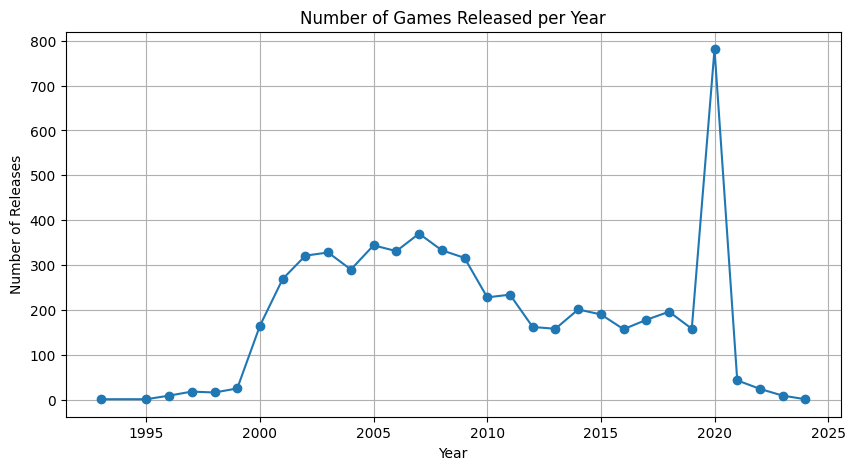

In [265]:
import matplotlib.pyplot as plt

# Use .loc[] to set the value of 'release_date' column
merged_df.loc[:, 'release_date'] = pd.to_datetime(merged_df['release_date'])

year = merged_df['release_date'].dt.year

# Count games released each year
yearly_releases = year.value_counts().sort_index()

# Plotting
plt.figure(figsize=(10, 5))
plt.plot(yearly_releases.index, yearly_releases.values, marker='o')
plt.title('Number of Games Released per Year')
plt.xlabel('Year')
plt.ylabel('Number of Releases')
plt.grid(True)
plt.show()


### genre and mean total sales 

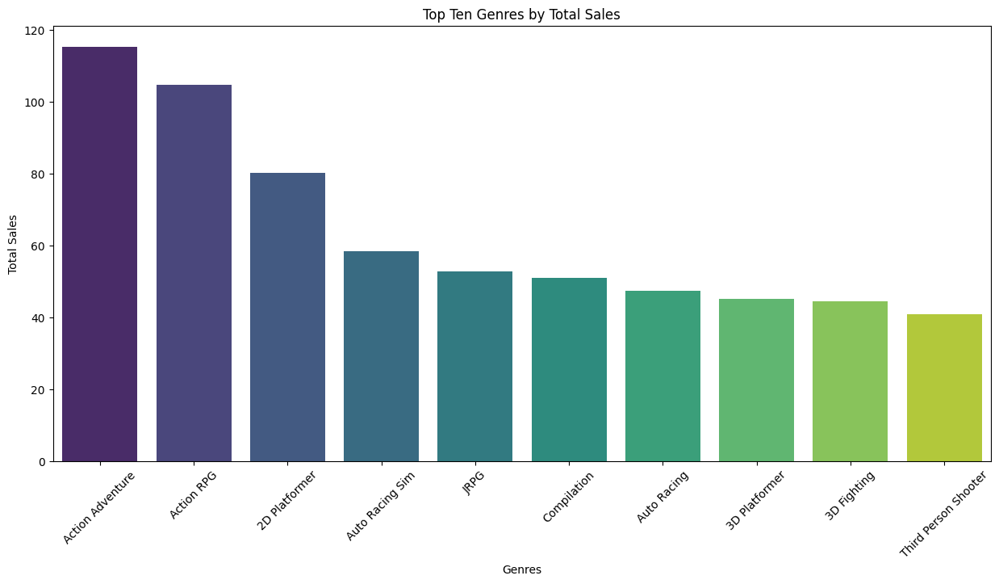

In [282]:
import seaborn as sns

genre_total_sales = merged_df.groupby('Genres')['total_sales'].sum().reset_index()

# Sort genres by total sales and select top ten
top_ten_genres = genre_total_sales.sort_values(by='total_sales', ascending=False).head(10)

# Plot top ten genres vs. total sales
plt.figure(figsize=(15, 7))
sns.barplot(data=top_ten_genres, x='Genres', y='total_sales', palette='viridis', hue='Genres', dodge=False)
plt.title('Top Ten Genres by Total Sales')
plt.xlabel('Genres')
plt.ylabel('Total Sales')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.legend([], frameon=False)  # Hide legend
plt.show()

#### Genres

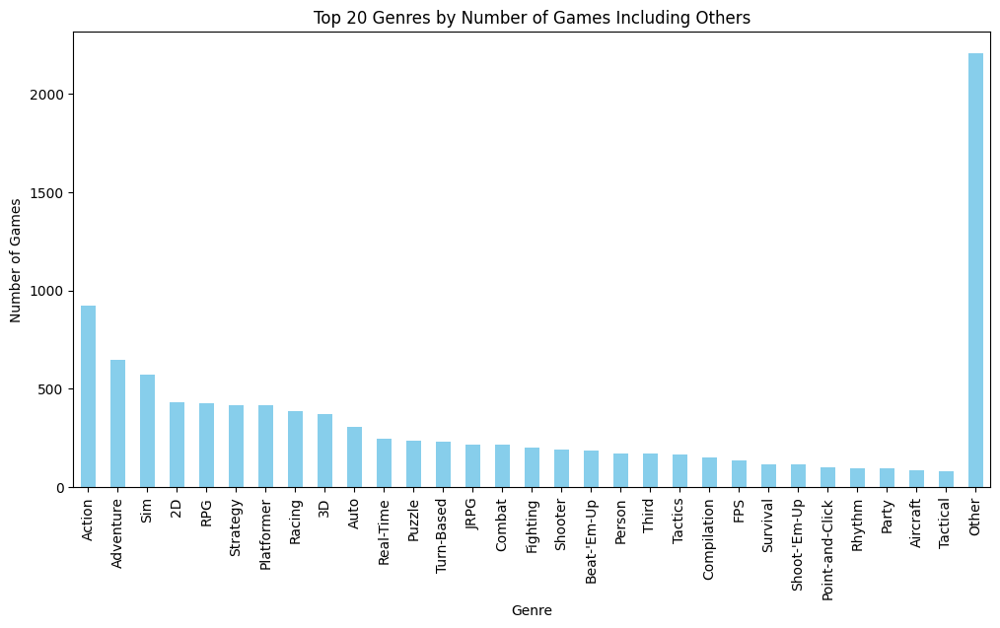

In [271]:
genres = merged_df['Genres'].str.split(' ').explode()
genres_counts = genres.value_counts()

top_selected_genres_count = 30

# Taking only the top 20 genres for visualization
top_genress = genres_counts.head(top_selected_genres_count)

# Group all genres outside the top 20 into 'Other'
others = genres_counts.tail(len(genres_counts) - top_selected_genres_count).sum()
top_genress['Other'] = others

plt.figure(figsize=(12, 6))
top_genress.plot(kind='bar', color='skyblue')
plt.title('Top 20 Genres by Number of Games Including Others')
plt.xlabel('Genre')
plt.ylabel('Number of Games')
plt.xticks(rotation=90)
plt.show()

#### Popularity Index and publisher

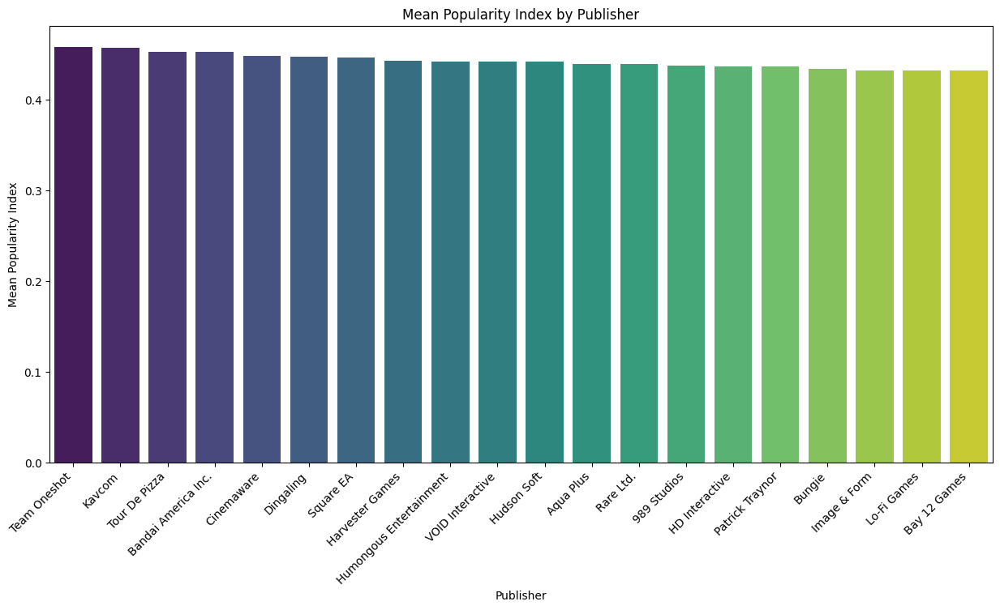

In [301]:
publisher_mean_popularity = merged_df.groupby('Publisher')['Popularity Index'].mean().reset_index()

# Sort publishers by mean popularity index
publisher_mean_popularity = publisher_mean_popularity.sort_values(by='Popularity Index', ascending=False).head(20)

# Plot publisher vs. popularity index
plt.figure(figsize=(15, 7))
sns.barplot(data=publisher_mean_popularity, x='Publisher', y='Popularity Index', palette='viridis', hue='Publisher', dodge=False)
plt.title('Mean Popularity Index by Publisher')
plt.xlabel('Publisher')
plt.ylabel('Mean Popularity Index')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.legend([], frameon=False)  # Hide legend
plt.show()

#### total sales and publisher

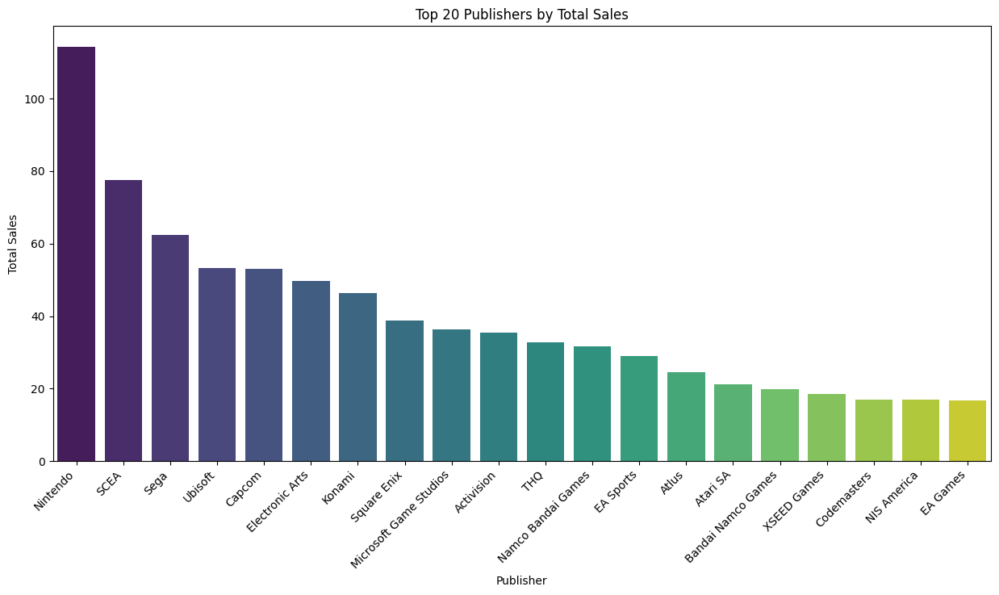

In [302]:
publisher_total_sales = merged_df.groupby('Publisher')['total_sales'].sum().reset_index()

# Sort publishers by total sales and select top 20
top_20_publishers = publisher_total_sales.sort_values(by='total_sales', ascending=False).head(20)

# Plot top 20 publishers vs. total sales
plt.figure(figsize=(15, 7))
sns.barplot(data=top_20_publishers, x='Publisher', y='total_sales', palette='viridis', hue='Publisher', dodge=False)
plt.title('Top 20 Publishers by Total Sales')
plt.xlabel('Publisher')
plt.ylabel('Total Sales')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.legend([], frameon=False)  # Hide legend
plt.show()

#### Popularity Index and total sales

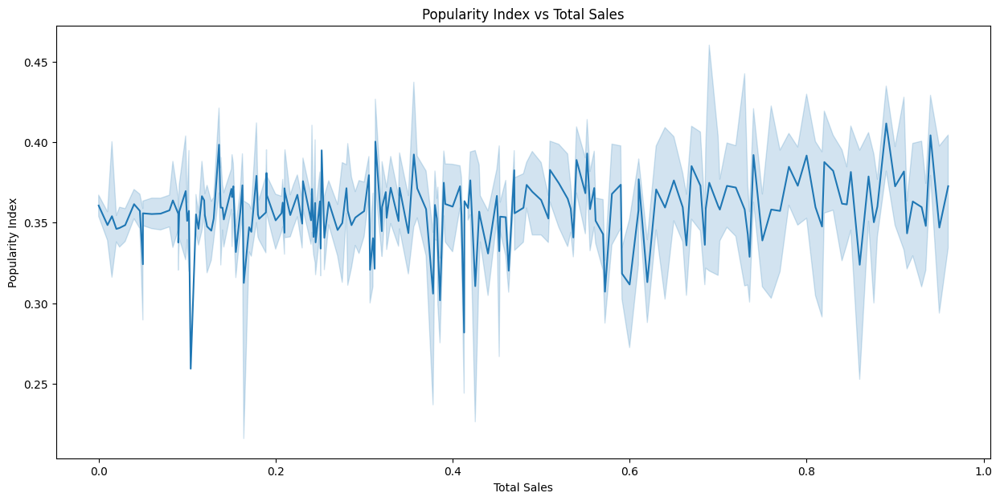

In [ ]:
# Scatter plot
plt.figure(figsize=(15, 7))
sns.lineplot(data=merged_df, x='total_sales', y='Popularity Index')
plt.title('Popularity Index vs Total Sales')
plt.xlabel('Total Sales')
plt.ylabel('Popularity Index')
plt.show()

#### Product Rating and total sales

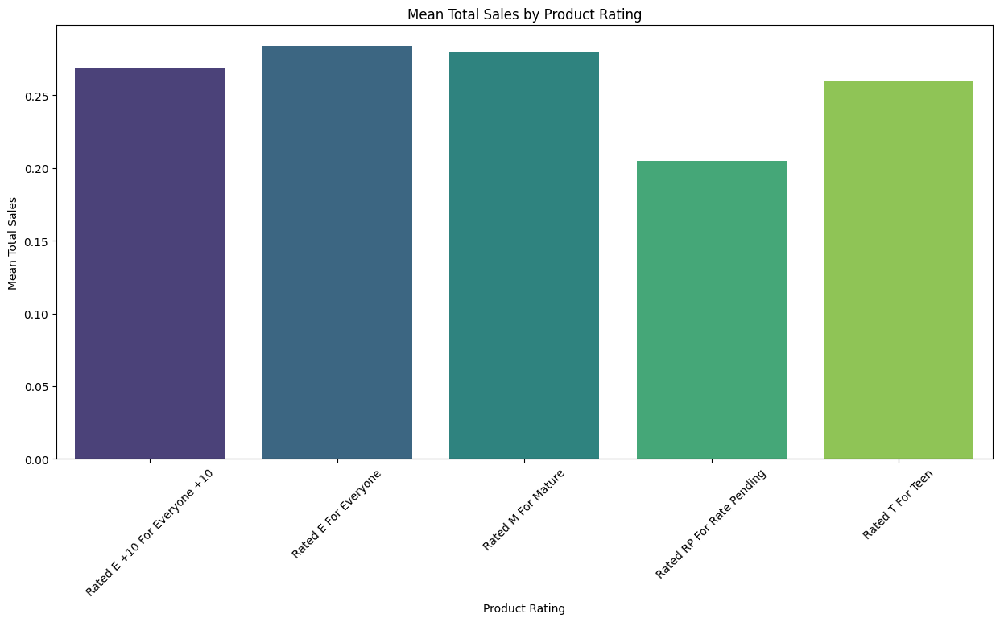

In [293]:
rating_mean_sales = merged_df.groupby('Product Rating')['total_sales'].mean().reset_index()

# Plot product rating vs. mean total sales
plt.figure(figsize=(15, 7))
sns.barplot(data=rating_mean_sales, x='Product Rating', y='total_sales', palette='viridis', hue='Product Rating', dodge=False)
plt.title('Mean Total Sales by Product Rating')
plt.xlabel('Product Rating')
plt.ylabel('Mean Total Sales')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.legend([], frameon=False)  # Hide legend
plt.show()

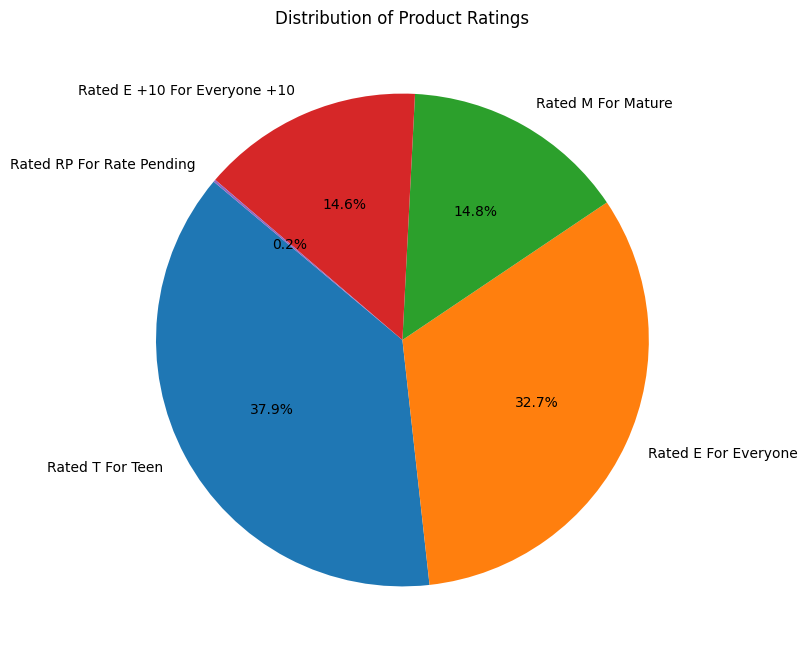

In [272]:
rating_counts = merged_df['Product Rating'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(rating_counts, labels=rating_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Product Ratings')
plt.show()

#### Publisher

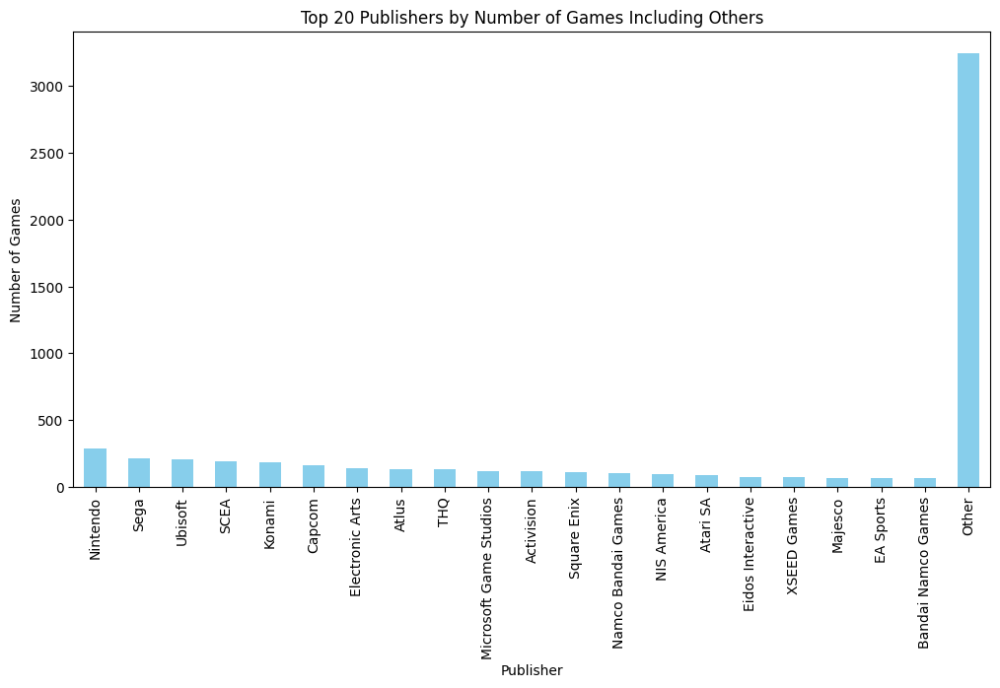

In [273]:
publisher_counts = merged_df['Publisher'].value_counts()

top_selected_publishers_count = 20

# Taking only the top 20 publishers for visualization
top_publishers = publisher_counts.head(top_selected_publishers_count)

# Group all publishers outside the top 20 into 'Other'
top_publishers = publisher_counts.head(top_selected_publishers_count)
others = publisher_counts.tail(len(publisher_counts) - top_selected_publishers_count).sum()
top_publishers['Other'] = others

plt.figure(figsize=(12, 6))
top_publishers.plot(kind='bar', color='skyblue')
plt.title('Top 20 Publishers by Number of Games Including Others')
plt.xlabel('Publisher')
plt.ylabel('Number of Games')
plt.xticks(rotation=90)
plt.show()

### Statistical comparison

In [274]:
import numpy as np

rating_mapping = {
    'Rated RP For Rate Pending': np.nan,
    'Rated E For Everyone': 0,
    'Rated E +10 For Everyone +10': 10,
    'Rated T For Teen': 13,
    'Rated M For Mature': 17
}

# Function to check if a game belongs to the 'Action' genre
def is_action(genres):
    if isinstance(genres, str):  # Check if genres is a string
        return 'Action' in genres.split()
    else:
        return False  # Return False for missing values

# Convert 'Product Ratings' column to numerical values
merged_df['Product Ratings Numeric'] = merged_df['Product Rating'].map(rating_mapping)

# Filter for action games
action_games = merged_df[merged_df['Genres'].apply(is_action)]

# Remove NaN values from 'Product Ratings Numeric' column
action_ratings = action_games['Product Ratings Numeric'].dropna()

average_action_rating = action_ratings.mean()

# Add a new column 'Product Rating Greater Than Average' and initialize it with NaN
merged_df['Product Rating Greater Than Average'] = np.nan

# Set 'Product Rating Greater Than Average' to 1 if 'Product Ratings Numeric' is greater than average_action_rating, otherwise set to 0
merged_df.loc[merged_df['Genres'].apply(is_action), 'Product Rating Greater Than Average'] = merged_df.loc[merged_df['Genres'].apply(is_action), 'Product Ratings Numeric'] > average_action_rating

# Convert boolean to int (1 or 0)
merged_df['Product Rating Greater Than Average'] = merged_df['Product Rating Greater Than Average'].apply(lambda x: 1 if x is True else (0 if x is False else np.nan))

pd.set_option('display.max_rows', None)

# Display the updated DataFrame
print(merged_df[['Genres', 'Product Ratings Numeric', 'Product Rating Greater Than Average']])


/tmp/ipykernel_12541/3123665198.py:33: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[False  True  True  True  True False  True  True False  True  True  True
  True  True False  True  True  True  True False  True False  True  True
 False  True  True False False  True  True  True  True  True False  True
 False  True  True False  True  True  True  True  True  True  True  True
 False False  True  True  True  True False  True  True  True  True  True
 False  True  True False  True  True False  True  True False  True False
  True  True  True  True  True  True  True  True False False  True False
 False False False False False  True False False  True  True  True  True
  True False  True  True  True False  True False  True False False  True
 False  True False False  True  True  True False  True  True  True  True
  True  True  True  True  True  True False False False  True False  True
 False  True  True  True  Tru

                              Genres  Product Ratings Numeric  \
1070                Action Adventure                     10.0   
1076                     3D Fighting                     17.0   
1077                      Action RPG                     13.0   
1079               Open-World Action                     17.0   
1080                     Auto Racing                     13.0   
1081            Third Person Shooter                     13.0   
1083                  Basketball Sim                      0.0   
1087              Real-Time Strategy                     13.0   
1088                          Tycoon                      0.0   
1089                            Golf                      0.0   
1090                    Baseball Sim                      0.0   
1101                Action Adventure                     17.0   
1102               Open-World Action                     17.0   
1106                    Football Sim                      0.0   
1112                     

In [275]:
merged_df.to_csv('filtered_merged_dataset2.csv', index=False)